In [1]:
import sys
import os 
sys.path.append(os.path.abspath(os.path.join("", "..")))
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
from torch import nn
from vanilla_vae import VanillaVAE
import wandb
import gc
device = "cuda:0"

In [2]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters())
def compute_model_size(model):
    dtype_size_map = {
        torch.float32: 4,  # 4 bytes for float32
        torch.float16: 2,  # 2 bytes for float16
        torch.float64: 8,  # 8 bytes for float64
        torch.int64: 8,    # 8 bytes for int64
        torch.int32: 4,    # 4 bytes for int32
        torch.int16: 2,    # 2 bytes for int16
        torch.int8: 1,     # 1 byte for int8
    }

    total_size_in_bytes = sum(
        p.numel() * dtype_size_map[p.dtype] for p in model.parameters()
    )
    total_size_in_gb = total_size_in_bytes / (1024 ** 3)
    return total_size_in_gb

## Game plan:

go as deep ad possible in analyzing vanilla VAE. try out:

- more betas
- different hidden dim
- more powerful decoder
- different activation functions (tanh)


## Loading weights dataset

In [3]:
torch.cuda.empty_cache()
gc.collect()

0

In [4]:
weights_path = '../weights_datasets/identities/all_weights.pt'
all_weights = torch.load(weights_path, map_location=torch.device("cpu"))

In [6]:
all_weights=all_weights.cpu()

In [5]:
torch.cuda.empty_cache()
gc.collect()

10

In [8]:
print(torch.cuda.memory_allocated())
print(torch.cuda.memory_reserved())

0
0


In [7]:
class w2wDataset(Dataset):
    def __init__(self, all_weights):
        self.all_weights = all_weights

    def __len__(self):
        return len(self.all_weights)

    def __getitem__(self, idx):
        return self.all_weights[idx]

train_ratio = 0.85
test_ratio = 0.05
val_ratio = 0.1
batch_size = 32

# Calculate the sizes of the splits
train_size = int(train_ratio * len(all_weights))
test_size = int(test_ratio * len(all_weights))
val_size = len(all_weights) - train_size - test_size

# Split the dataset
full_dataset = w2wDataset(all_weights)
train_dataset, test_dataset, val_dataset = torch.utils.data.random_split(full_dataset, [train_size, test_size, val_size])

# Create the dataloaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

print(len(train_loader))
print(len(val_loader))
print(len(test_loader))

1726
204
102


## Creating VAE

In [8]:
import importlib
from vae_w2w.vanilla_vae import VanillaVAE
from vae_w2w.vae_annealed import AnnealedVAE
import vae_w2w.vanilla_vae
import vae_w2w.vae_annealed
importlib.reload(vae_w2w.vanilla_vae)
importlib.reload(vae_w2w.vae_annealed)

<module 'vae_w2w.vae_annealed' from '/home/ubuntu/weights2weightspp/vae_w2w/vae_annealed.py'>

In [7]:
in_dim = len(all_weights[0])
latent_dim = 1000 
hidden_dims = [2048]

beta_start = 1e-6
beta_end = 0.01
num_range = 800
num_end = 200

vae = AnnealedVAE(in_dim, latent_dim, hidden_dims, beta_start, beta_end, num_range, num_end).to(device)
print(count_parameters(vae),"params")
print(compute_model_size(vae),"GB")

vae.train()

414407952 params
1.5437899231910706 GB


AnnealedVAE(
  (encoder): Sequential(
    (0): Sequential(
      (0): Linear(in_features=99648, out_features=2048, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
    )
  )
  (fc_mu): Linear(in_features=2048, out_features=1000, bias=True)
  (fc_var): Linear(in_features=2048, out_features=1000, bias=True)
  (decoder_input): Linear(in_features=1000, out_features=2048, bias=True)
  (decoder): Sequential()
  (final_layer): Sequential(
    (0): Linear(in_features=2048, out_features=99648, bias=True)
    (1): Tanh()
  )
)

## Train model

In [8]:
def evaluate(dataloader, dataname, vae):
    size = len(dataloader.dataset)
    vae.eval()
    avg_loss = 0
    with torch.no_grad():
        for weights in dataloader:
            weights = weights.to(device)
            recon, mu, log_var = vae(weights)
            losses = vae.loss(weights, recon, mu, log_var) #TODO: balance beta in beta-VAE (normalization approach)
            avg_loss += losses['loss']
    avg_loss /= size
    print(f"{dataname} avg loss = {avg_loss:>8f}")
    return avg_loss

In [9]:
epochs = 3
lr = 1e-4
optimizer = torch.optim.Adam(vae.parameters(), lr=lr)

wandb_name = f"cyclical_annealed-vae-latent_dim{latent_dim}_lr{lr}_betaS{beta_start}_betaE{beta_end}_betacycle{num_range}-{num_end}"

wandb.init(
        project="w2w-proj",
        name=wandb_name,
    )
wandb.log({'lr':lr, 'latent_dim':latent_dim})
torch.cuda.empty_cache()

# Training loop
for epoch in range(epochs):
    vae.train()
    cur_num_examples = 0
    for i, weights in enumerate(train_loader):
        weights = weights.to(device)
        # normalizing but rough
        optimizer.zero_grad()
        recon, mu, log_var = vae(weights)
        losses = vae.loss(weights, recon, mu, log_var)
        loss = losses['loss']
        kl_loss = losses['KLD']
        recon_loss = losses['Reconstruction_Loss']
        beta = losses['beta']
        loss.backward()
        optimizer.step()
        if i % 500 == 0:
            print(f"Epoch[{epoch}/{epochs}], Step [{i}/{len(train_loader)}], Loss: {loss.item():.8f}")

        cur_num_examples += weights.shape[0]
        wandb.log({"Num of examples seen": epoch*len(train_loader.dataset) + cur_num_examples,
                    "Loss": loss, "KL Loss": kl_loss, "recon loss": recon_loss, 'beta':beta})

    print(f"Epoch[{epoch}/{epochs}]")
    train_avg_loss = evaluate(train_loader, "Train", vae)
    test_avg_loss = evaluate(test_loader, "Test", vae)
    val_avg_loss = evaluate(val_loader, "Validation", vae)

    wandb.log({"Epoch": epoch,
                "Train Avg Loss": train_avg_loss,
                "Test Avg Loss": test_avg_loss,
                "Validation Avg Loss": val_avg_loss,})

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: fzmautner (fzmautner-carnegie-mellon-university). Use `wandb login --relogin` to force relogin


OutOfMemoryError: CUDA out of memory. Tried to allocate 780.00 MiB. GPU 

In [43]:
# Save the trained model
# model_save_path = f"temp_annealed_vae_latent{latent_dim}"
model_save_path = wandb_name
if not os.path.exists(model_save_path):
    os.makedirs(model_save_path)

torch.save(vae.state_dict(), os.path.join(model_save_path, "model.pt"))
print(f"Model saved to {model_save_path}")


Model saved to annealed-vae-latent_dim1000_lr0.0001_betaS1e-06_betaE0.01_betaSteps1200_aws1


## Evaluate model

In [13]:
# latent_dim=512
# beta=0.01

# vae = VanillaVAE(input_dim=99648, latent_dim=latent_dim, hidden_dims=[2048], beta=beta, batch_norm=False)


# model_save_path = f"temp_vanilla_vae_latent{latent_dim}_beta{beta}"
# vae.load_state_dict(torch.load(os.path.join(model_save_path, "model.pt")))
# vae = vae.to(device)
# print(f"Model loaded from {model_save_path}")

Model loaded from temp_vanilla_vae_latent512_beta0.01


In [4]:
import importlib
import vae_w2w.vanilla_vae
importlib.reload(vae_w2w.vanilla_vae)
from vae_w2w.vanilla_vae import VanillaVAE

In [5]:
import vae_w2w.vae_tester
importlib.reload(vae_w2w.vae_tester)
from vae_w2w.vae_tester import VAESampleTester

In [23]:
torch.cuda.empty_cache()
gc.collect()

112

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Exception ignored in: <function VAESampleTester.__del__ at 0x74704182f920>
Traceback (most recent call last):
  File "/home/ubuntu/weights2weightspp/vae_w2w/vae_tester.py", line 127, in __del__
    self.cleanup()
  File "/home/ubuntu/weights2weightspp/vae_w2w/vae_tester.py", line 122, in cleanup
    if self.pipe:
       ^^^^^^^^^
AttributeError: 'VAESampleTester' object has no attribute 'pipe'


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 0 results:


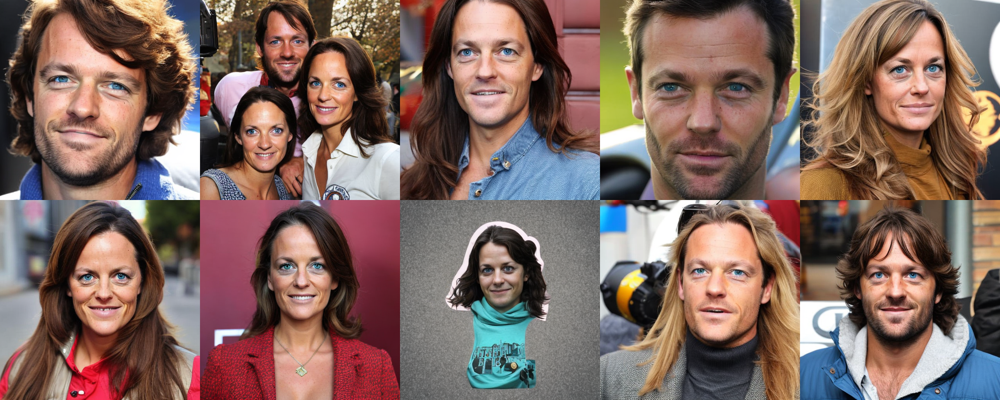

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 1 results:


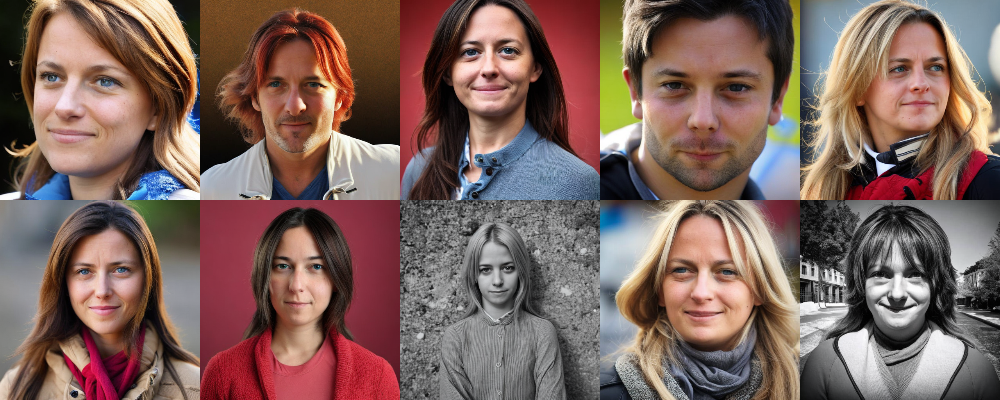

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 2 results:


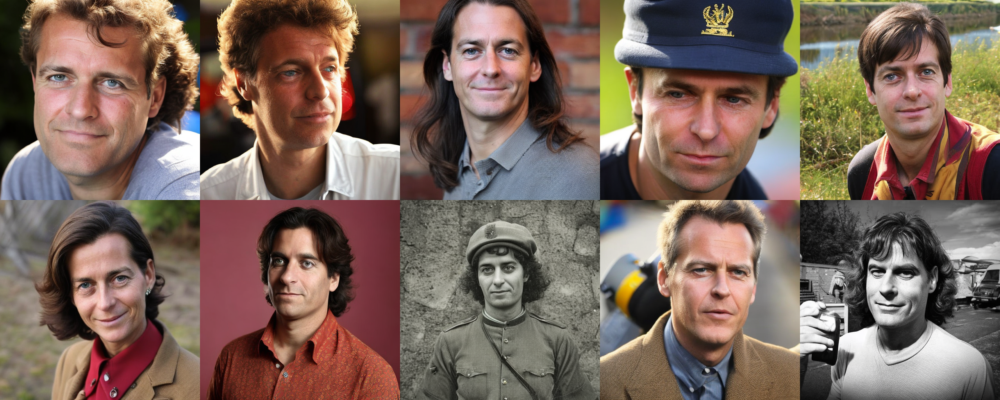

In [42]:
# Setup
vae.eval()
results = vae.sample(20, device)
weight_dimensions = torch.load('../files/weight_dimensions.pt')

# Initialize the tester
tester = VAESampleTester(
    vae=vae,
    weight_dimensions=weight_dimensions,
    device=device
)

# Generate and display images from different samples
def compare_samples(sample_indices, n_images_per_sample=10):
    all_grids = []
    for idx in sample_indices:
        # Generate images
        images = tester.generate_from_sample(
            sample_idx=idx,
            vae_samples=results,
            n_images=n_images_per_sample
        )
        
        # Create grid
        grid = tester.create_image_grid(images)
        all_grids.append(grid)
        
        # Log images to wandb
        if wandb.run is not None:
            wandb.log({
                f"sample_{idx}_grid": wandb.Image(grid),
                "sample_index": idx
            })

        print(f"Sample {idx} results:")
        display(grid)
        print("\n")

        del images, grid

# Compare different samples
compare_samples([0, 1, 2])

# Clean up when done
tester.cleanup()

In [21]:
try:
    del vae, results, tester, all_grids, images, grid
except:
    pass

In [6]:
# Reset all CUDA devices
torch.cuda.reset_peak_memory_stats()
for i in range(torch.cuda.device_count()):
    torch.cuda.reset_peak_memory_stats(i)
    torch.cuda.reset_accumulated_memory_stats(i)

## Test interpolation

torch.Size([5, 512])


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Exception ignored in: <function VAESampleTester.__del__ at 0x74704182f920>
Traceback (most recent call last):
  File "/home/ubuntu/weights2weightspp/vae_w2w/vae_tester.py", line 127, in __del__
    self.cleanup()
  File "/home/ubuntu/weights2weightspp/vae_w2w/vae_tester.py", line 122, in cleanup
    if self.pipe:
       ^^^^^^^^^
AttributeError: 'VAESampleTester' object has no attribute 'pipe'


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 0 results:


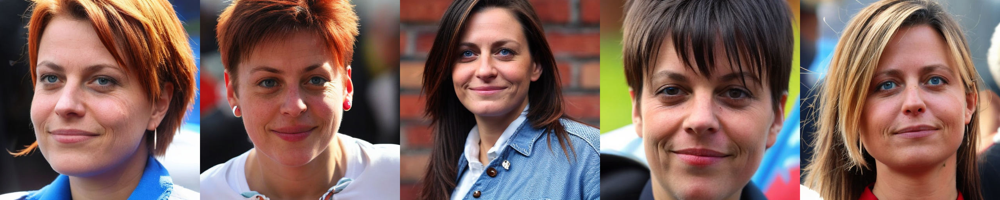

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 1 results:


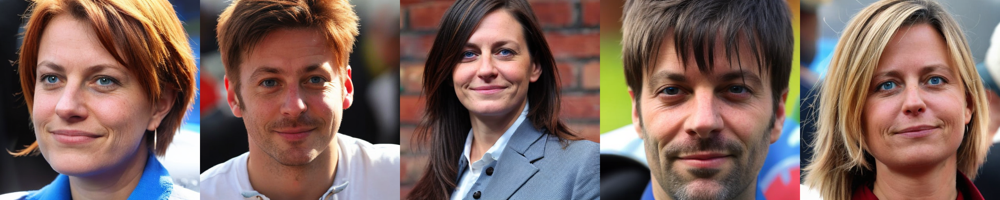

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 2 results:


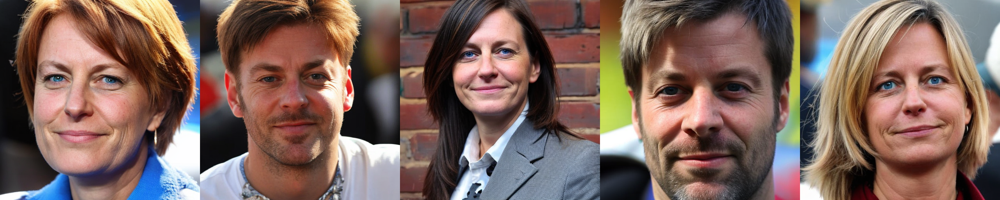

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 3 results:


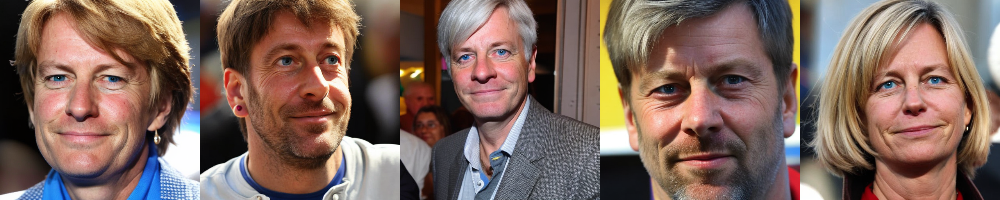

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Sample 4 results:


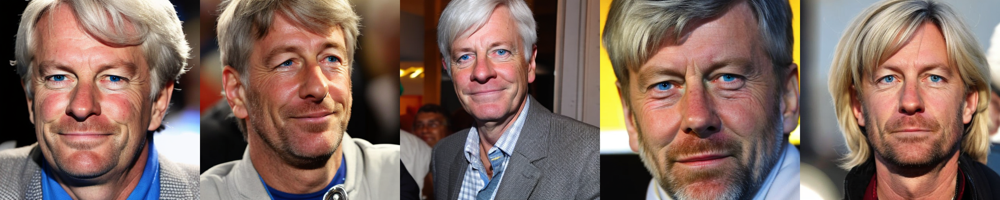

In [24]:
# Setup
vae.eval()

# Generate two random latent vectors
generator = torch.Generator(device=device)
generator.manual_seed(10423)
zs = torch.randn(6, vae.latent_dim, device=device, generator=generator)
z1 = zs[1]
z2 = zs[5]

n_in_between = 3
total = n_in_between + 2

# Interpolate in latent space
alpha_values = torch.linspace(0, 1, total, device=device)
interpolated_latents = torch.zeros((total, vae.latent_dim), device=device)
for i, alpha in enumerate(alpha_values):
    interpolated_latents[i] = (1 - alpha) * z1 + alpha * z2

print(interpolated_latents.shape)
interpolated_results = vae.decode(interpolated_latents)


weight_dimensions = torch.load('../files/weight_dimensions.pt')

# Initialize the tester
tester = VAESampleTester(
    vae=vae,
    weight_dimensions=weight_dimensions,
    device=device
)

# Generate and display images from different samples
def compare_samples(sample_indices, n_images_per_sample=5):
    all_grids = []
    for idx in sample_indices:
        # Generate images
        images = tester.generate_from_sample(
            sample_idx=idx,
            vae_samples=interpolated_results,
            n_images=n_images_per_sample
        )
        
        # Create grid
        grid = tester.create_image_grid(images)
        all_grids.append(grid)
        
        print(f"Sample {idx} results:")
        display(grid)
        print("\n")

        del images, grid

# Compare different samples
compare_samples([0, 1, 2, 3, 4])

# Clean up when done
tester.cleanup()

In [25]:
all_grids.shape

NameError: name 'all_grids' is not defined

## Test reconstruction of original weights by VAE

In [35]:
og = all_weights[[1]].cuda()
reconstructed, mu, logvar = vae.forward(og)

In [20]:
torch.linspace(0,1,3)

tensor([0.0000, 0.5000, 1.0000])

In [36]:
# Initialize tester with weight dimensions
tester_og = VAESampleTester(None, weight_dimensions, device="cuda:0")

# Generate images from reconstructed weights
images = tester.generate_from_sample(
    sample_idx=0,
    vae_samples=og,
    n_images=10,
    seed_start=42,
    prompt="sks person",
    negative_prompt="low quality, blurry, unfinished",
    guidance_scale=3.0,
    num_inference_steps=50
)

# Create and display image grid
grid = tester.create_image_grid(images)
display(grid)

# Cleanup
del images, grid
tester.cleanup()


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

AttributeError: 'VAESampleTester' object has no attribute 'pipe'

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

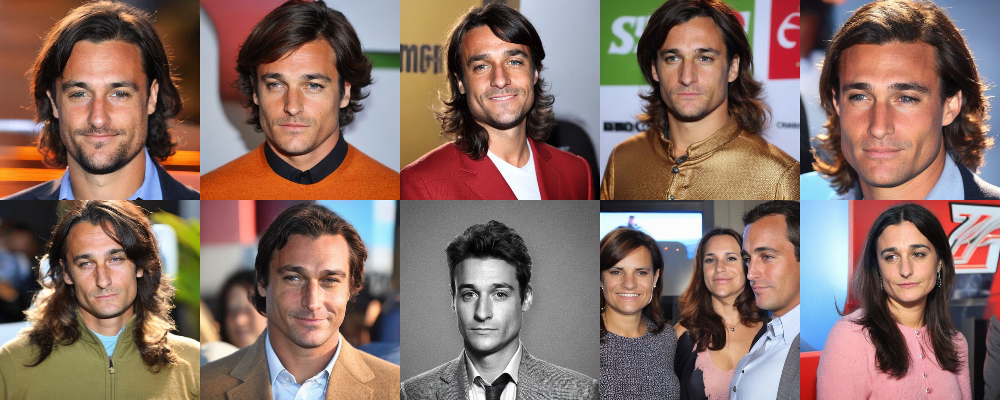

In [34]:
# Initialize tester with weight dimensions
tester = VAESampleTester(None, weight_dimensions, device="cuda:0")

# Generate images from reconstructed weights
images = tester.generate_from_sample(
    sample_idx=0,
    vae_samples=reconstructed,
    n_images=10,
    seed_start=42,
    prompt="sks person",
    negative_prompt="low quality, blurry, unfinished",
    guidance_scale=3.0,
    num_inference_steps=50
)

# Create and display image grid
grid = tester.create_image_grid(images)
display(grid)

# Cleanup
del images, grid
tester.cleanup()


In [33]:
vae.beta

0.01